# Non Tidal Fortnightly Average [Good]

In [6]:
import mikeio
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
from datetime import datetime, timedelta
from calendar import monthrange

# Function for calculating the average of each column the dataframe except the date column and then transposing it
def df_column_avg(df):
    
    a_df = pd.DataFrame(df.loc[:, df.columns != "Date"].mean())
    ret_df = a_df.transpose()
    
    return ret_df

for file in glob.glob(r"G:\MJI\Non Tidal (172 nos.)\Output\Good\Daily_Avg\*.xlsx"):
    
    # Splitting the path list by seperator as a list
    path_list = file.split(os.sep)

    # Reading the daily average excel file
    df = pd.read_excel(file)

    # Converting the 'Date' column to datetime format
    df['Date'] = pd.to_datetime(df['Date'],format='%d/%m/%Y')

    # Defining a dictionary to store the year, month and montn's first date and last date
    start_end_time_dict = {}

    # Looping through all the year to whole timeseries montly start and end date dictionary
    for yr in df['Date'].dt.year.unique():

        # Defining a dictionary to store the yearly month start and end date dictionary
        year_dict = {}

        # Subsetting the yearly data from timeseries data
        yr_df = df[df['Date'].dt.strftime('%Y') == str(yr)]

        # Looping through each month of yearly subset data
        for month in yr_df['Date'].dt.month.unique():

            # Defining a list to store the first and last day of the month
            start_end_time_list = []

            # Subsetting the month data from the yearly data
            month_df = yr_df[yr_df['Date'].dt.month == month]

            # Finding the start date and end date of the month
            first_day = month_df['Date'].min()
            last_day = month_df['Date'].max()

            # Appending the first date and end date to the start_end_time list
            start_end_time_list.append(first_day)
            start_end_time_list.append(last_day)

            # Appending the monthly dictionary to the yearly dictionary
            year_dict[str(month)] = start_end_time_list

        # Appending the yearly dictionary to the total timeseries dictionary
        start_end_time_dict[str(yr)] = year_dict


    # Defining a dataframe to store the fortnightly mean water level value
    wl_df = pd.DataFrame()

    # Total number time segment in a month (example: fortnightly-2, weekly-4 etc.) [User Input]
    N = 2   ## Fortnightly

    # Looping through timeseries dictionary to get the start date and end date of a month
    for yr_key in start_end_time_dict:
        for month_key in start_end_time_dict[yr_key]:
            first_date = start_end_time_dict[yr_key][month_key][0]
            last_date = start_end_time_dict[yr_key][month_key][1]

            # Converting start date and end date of the month to datetime
            start_datetime = pd.to_datetime(first_date)
            end_datetime = pd.to_datetime(last_date)


            # Defining a dataframe to store the fortnightly date of the month
            dtm_list = []

            # Finding the difference between start date and end date of the month
            diff = end_datetime - start_datetime + timedelta(days=1)

            # Finding segment dates
            increment = (diff.round('D') - timedelta(days = diff.round('D').days % N))/ N

            for idx in range(1, N+1, 1):

                if idx == 0:
                    dtm_list.append((start_datetime + idx * increment).strftime("%Y/%m/%d"))

                elif 0 < idx < N:
                    dtm_list.append((start_datetime + idx * increment - timedelta(days=1)).strftime("%Y/%m/%d"))

                else:
                    dtm_list.append((end_datetime).strftime("%Y/%m/%d"))


            for i in range(0,len(dtm_list)):

                if i == 0:
                    mask = (df['Date'] >= first_date) & (df['Date'] <= dtm_list[i])
                    v_df = df.loc[mask]


                    fdt_df = pd.DataFrame({'Date/Time':[dtm_list[i]]})
                    avg_df = df_column_avg(v_df)
                    n_df = pd.concat([fdt_df,avg_df], axis=1, join="inner")
                    n_df['Remarks'] = i+1

                    wl_df = pd.concat([wl_df, n_df])

                elif 0 < i < len(dtm_list):
                    mask = (df['Date'] > dtm_list[i-1]) & (df['Date'] <= dtm_list[i])
                    v_df = df.loc[mask]

                    fdt_df = pd.DataFrame({'Date/Time':[dtm_list[i]]})
                    avg_df = df_column_avg(v_df)
                    n_df = pd.concat([fdt_df,avg_df], axis=1, join="inner")
                    n_df['Remarks'] = i+1

                    wl_df = pd.concat([wl_df, n_df])

                else:
                    break

    # Saving the fortnightly average water level dataframe
    wl_df.to_excel(r'G:\MJI\Non Tidal (172 nos.)\Output\Good\Fortnightly_Avg\{}_Fortnightly_Avg.xlsx'.format(path_list[-1][:-18]),
                  float_format="%.4f", index= False)
    
    print(path_list[-1][:-18])

SW10 (Simulbari)
SW101.5 (Kamarkhali_Gondhakhali)
SW11 (Khanpur)
SW11A (Shariakandi)
SW132.2 (Phulbari)
SW132.5 (Joypurhat)
SW133 (Naogaon)
SW134 (Jukerchar)
SW135A (Juricont_Silghat)
SW137A (Taraghat)
SW14 (Mirzapur_Bangshi)
SW142.1 (Bhusirbandar)
SW147 (Atrai Rly. Bridge)
SW147.5 (Singra)
SW148 (Chanchkair)
SW149 (Astamanisha)
SW151 (Baghabari)
SW155 (Mohimaganj Rly. Crossing)
SW15J (Mathurpara_Milanpur)
SW169 (Mazurdia)
SW172.5 (Amalshid)
SW173 (Sheola)
SW174 (Fenchuganj)
SW175.5 (Sherpur)
SW181 (Gunabati Rly. Bridge)
SW192 (Motiganj)
SW201 (Monu Rly. Bridge)
SW202 (Moulovi Bazar)
SW203 (Lama)
SW205 (Kazipur)
SW206 (Hatboalia)
SW207 (Chuadanga)
SW208 (Darsana)
SW211.5 (Chapai Nawabganj)
SW216 (Magura)
SW216A (Magura Diversion)
SW223 (Goalkanda)
SW232 (Phulbari_Outfall)
SW233 (Protappur_Piyanganj)
SW236 (Dinajpur_Pulhat)
SW238 (Rohanpur)
SW247 (Bandarban)
SW251 (Sarighat)
SW252 (Gowainghat)
SW252.1 (Salutikar)
SW261 (Nawhata)
SW263.1 (Kalmakanda)
SW265 (Jaldhup)
SW266 (Kanairghat)
SW

SW10 (Simulbari)_Fortnightly_Avg
SW101.5 (Kamarkhali_Gondhakhali)_Fortnightly_Avg
SW11 (Khanpur)_Fortnightly_Avg
SW11A (Shariakandi)_Fortnightly_Avg
SW132.2 (Phulbari)_Fortnightly_Avg
SW132.5 (Joypurhat)_Fortnightly_Avg
SW133 (Naogaon)_Fortnightly_Avg
SW134 (Jukerchar)_Fortnightly_Avg
SW135A (Juricont_Silghat)_Fortnightly_Avg
SW137A (Taraghat)_Fortnightly_Avg
SW14 (Mirzapur_Bangshi)_Fortnightly_Avg
SW142.1 (Bhusirbandar)_Fortnightly_Avg
SW147 (Atrai Rly. Bridge)_Fortnightly_Avg
SW147.5 (Singra)_Fortnightly_Avg
SW148 (Chanchkair)_Fortnightly_Avg
SW149 (Astamanisha)_Fortnightly_Avg
SW151 (Baghabari)_Fortnightly_Avg
SW155 (Mohimaganj Rly. Crossing)_Fortnightly_Avg
SW15J (Mathurpara_Milanpur)_Fortnightly_Avg
SW169 (Mazurdia)_Fortnightly_Avg


C:\Users\MDS\anaconda3\envs\py377\lib\site-packages\ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


SW172.5 (Amalshid)_Fortnightly_Avg
SW173 (Sheola)_Fortnightly_Avg
SW174 (Fenchuganj)_Fortnightly_Avg
SW175.5 (Sherpur)_Fortnightly_Avg
SW181 (Gunabati Rly. Bridge)_Fortnightly_Avg
SW192 (Motiganj)_Fortnightly_Avg
SW201 (Monu Rly. Bridge)_Fortnightly_Avg
SW202 (Moulovi Bazar)_Fortnightly_Avg
SW203 (Lama)_Fortnightly_Avg
SW205 (Kazipur)_Fortnightly_Avg
SW206 (Hatboalia)_Fortnightly_Avg
SW207 (Chuadanga)_Fortnightly_Avg
SW208 (Darsana)_Fortnightly_Avg
SW211.5 (Chapai Nawabganj)_Fortnightly_Avg
SW216 (Magura)_Fortnightly_Avg
SW216A (Magura Diversion)_Fortnightly_Avg
SW223 (Goalkanda)_Fortnightly_Avg
SW232 (Phulbari_Outfall)_Fortnightly_Avg
SW233 (Protappur_Piyanganj)_Fortnightly_Avg
SW236 (Dinajpur_Pulhat)_Fortnightly_Avg
SW238 (Rohanpur)_Fortnightly_Avg
SW247 (Bandarban)_Fortnightly_Avg
SW251 (Sarighat)_Fortnightly_Avg
SW252 (Gowainghat)_Fortnightly_Avg
SW252.1 (Salutikar)_Fortnightly_Avg
SW261 (Nawhata)_Fortnightly_Avg
SW263.1 (Kalmakanda)_Fortnightly_Avg
SW265 (Jaldhup)_Fortnightly_Avg


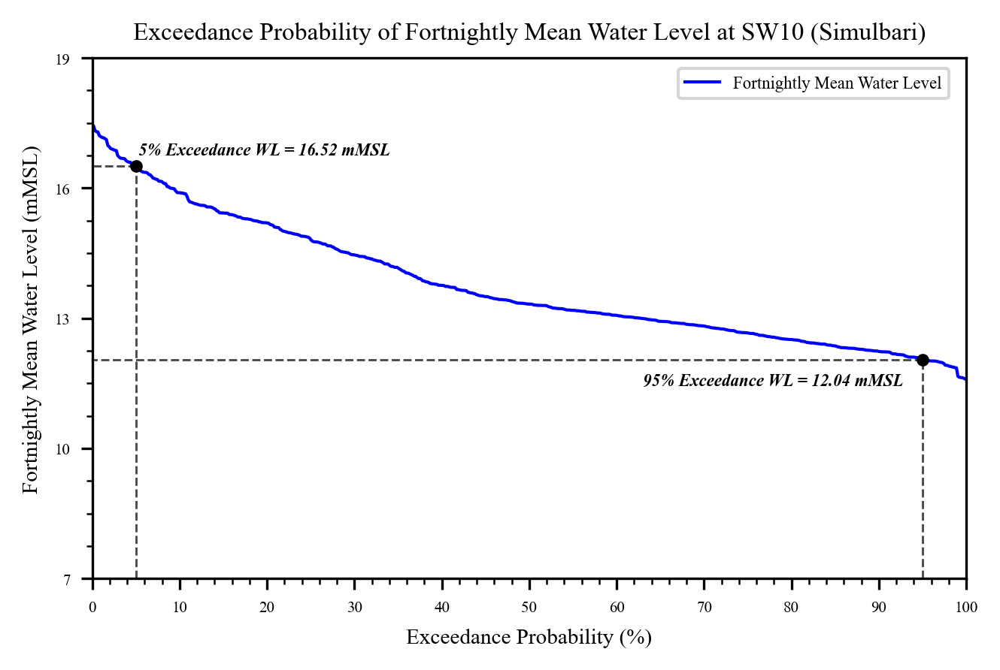

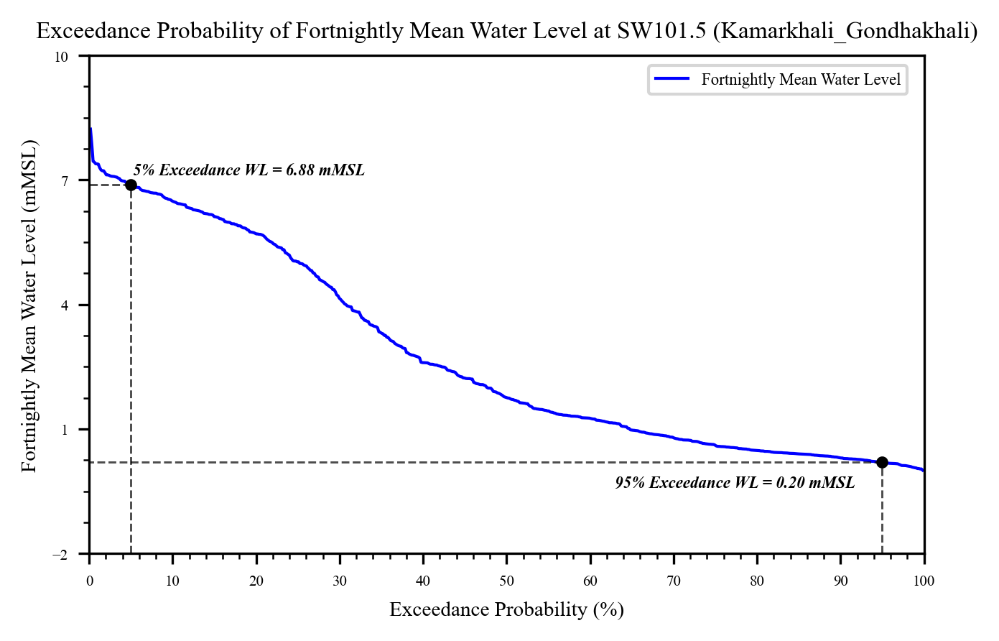

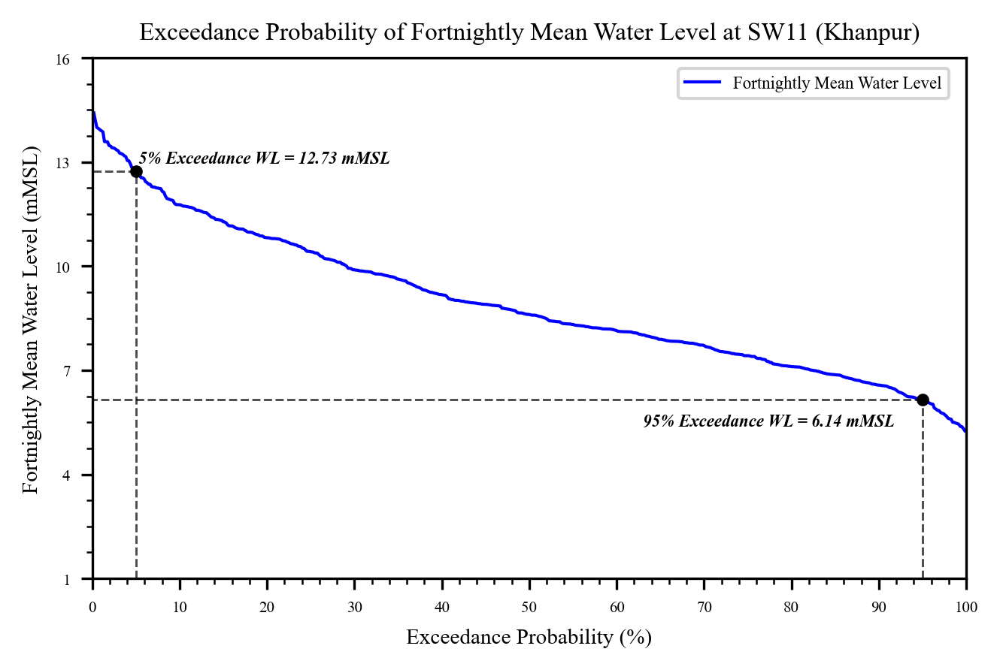

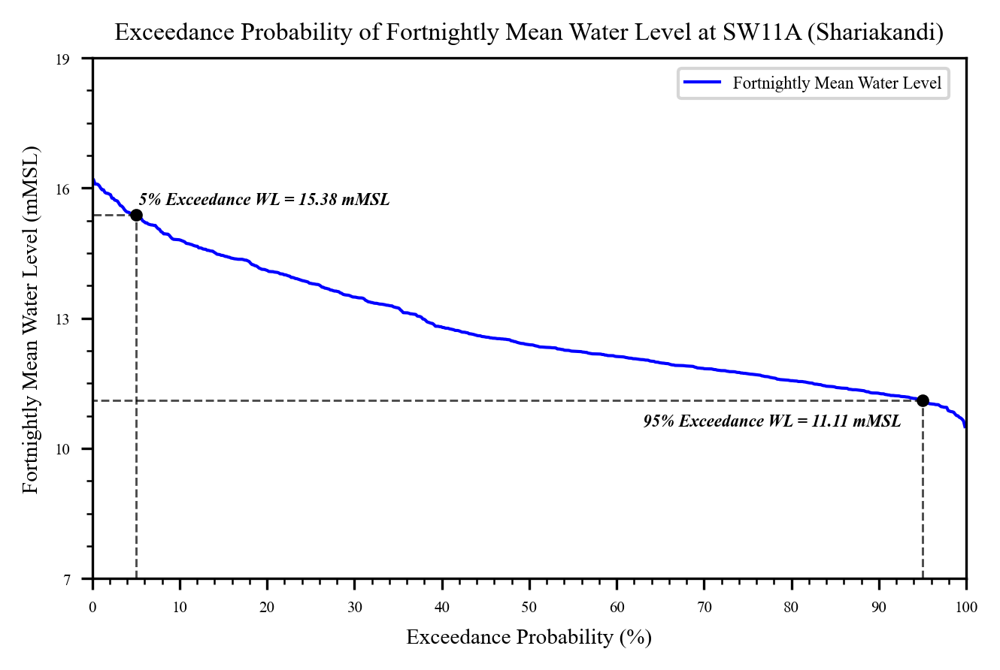

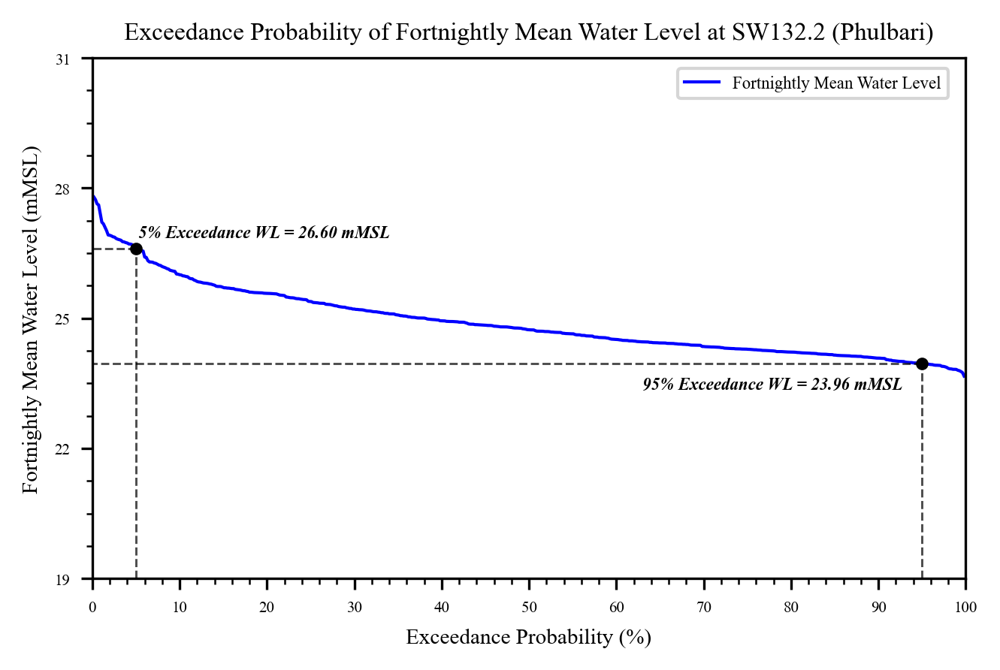

...

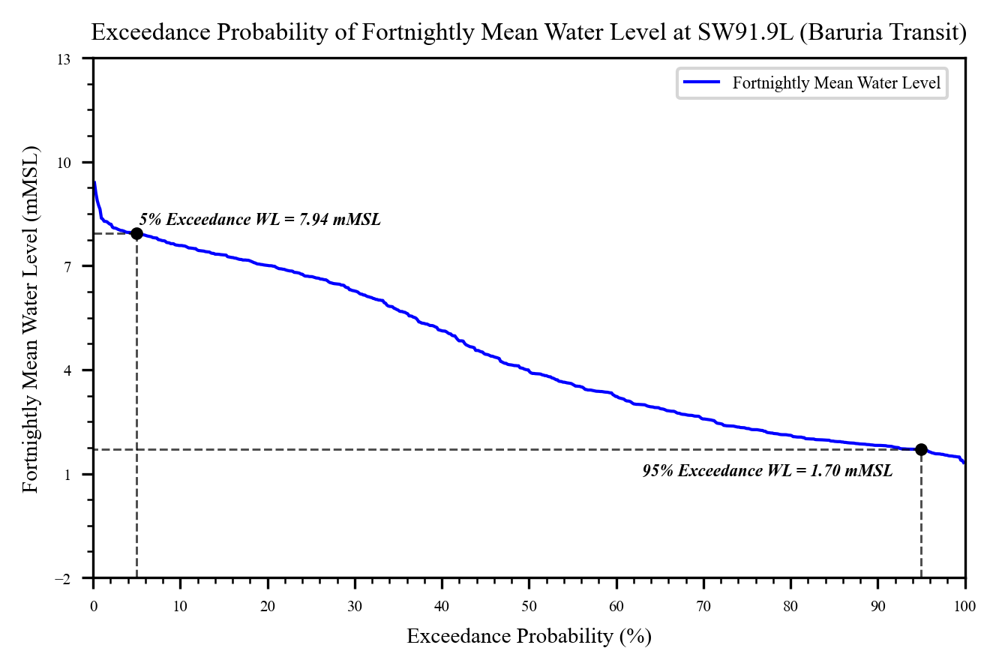

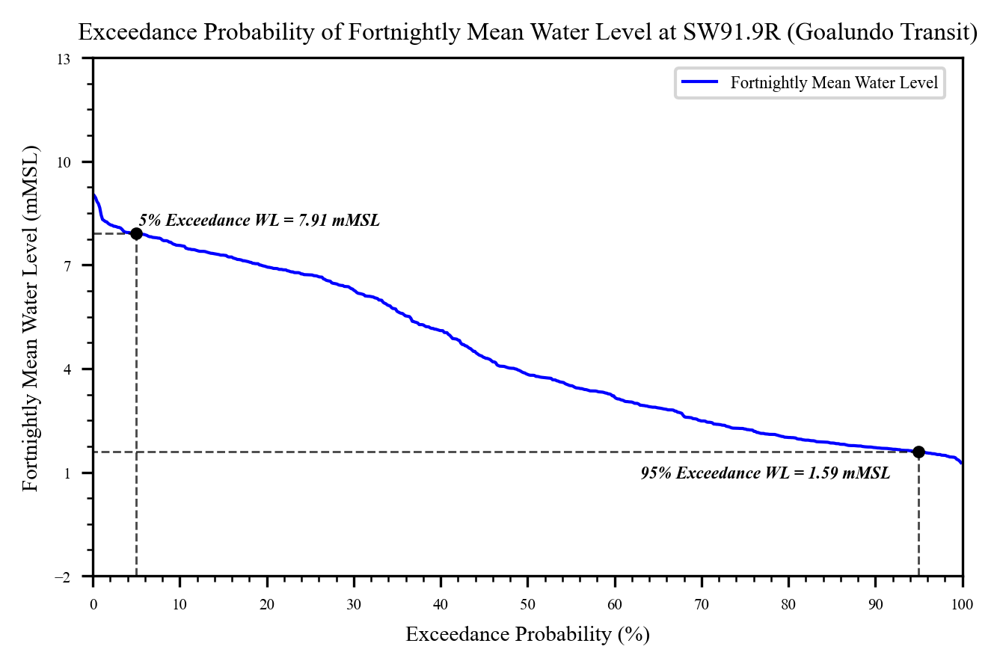

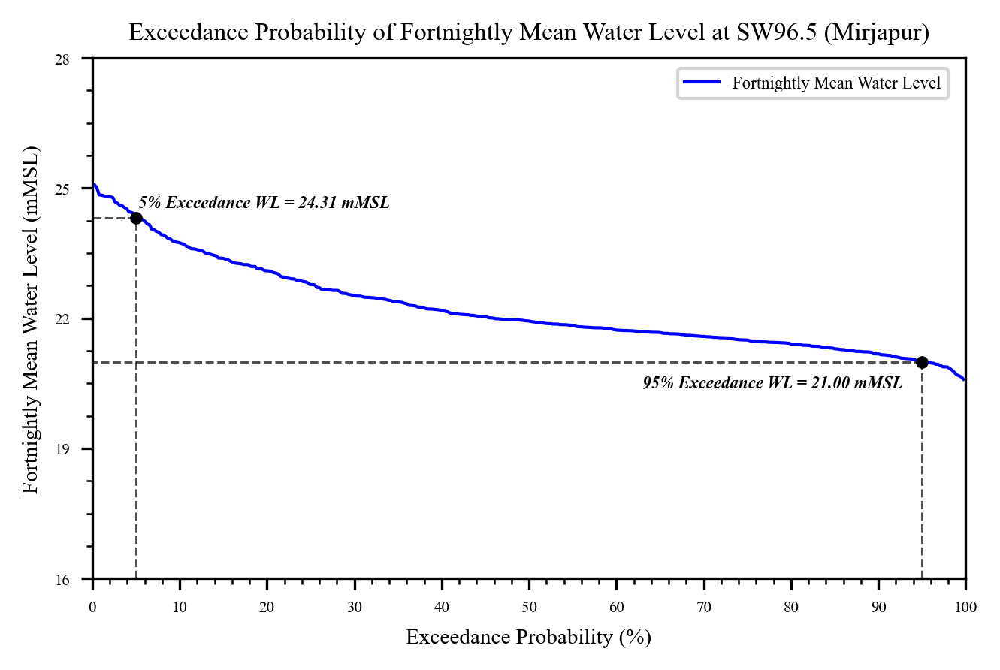

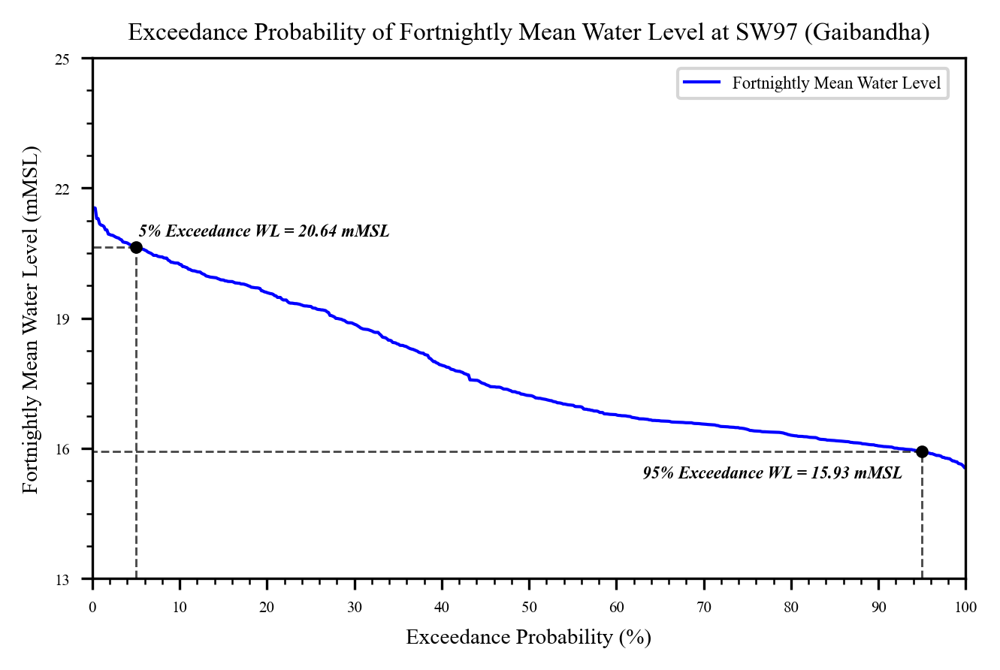

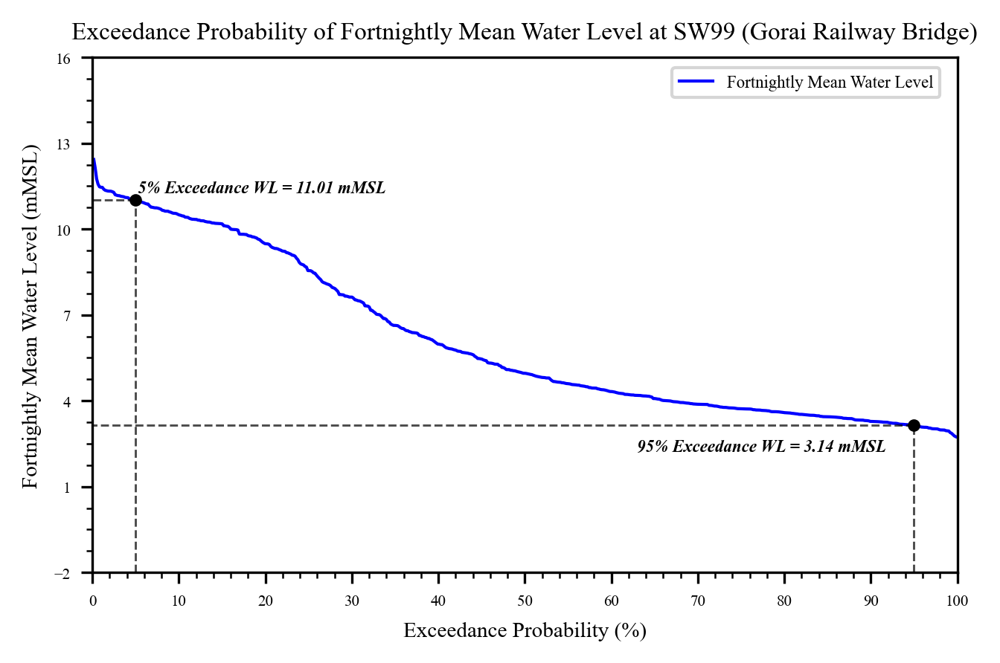

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import os
import glob

e_df = pd.DataFrame()

for file in glob.glob(r'G:\MJI\Non Tidal (172 nos.)\Output\Good\Fortnightly_Avg\*.xlsx'):
    
    try:
        path_list = file.split(os.sep)

        df = pd.read_excel(file)

        #Exceedance Probability Calculation

        df.dropna(subset=['Modified'],inplace = True)
        df.sort_values(by ='Modified', ascending=False, inplace = True)
        df['Ranking'] = df['Modified'].rank(method='min', ascending=False)
        df['Exceedence Probability (%)'] = (df.loc[:,'Ranking']*100)/(len(df['Modified'])+1)


        # Exceedance Probability Plotting

        font={'family':'Times New Roman',
             'weight':'normal',
             'size':5.5}

        plt.rc('font',**font)
        plt.rc('xtick',labelsize=5)
        plt.rc('ytick',labelsize=5)

        plt.figure(figsize=(5,3),dpi=300)

        x_axis = df['Exceedence Probability (%)']  # input
        y_axis = df['Modified']                # input

        plt.plot(x_axis, y_axis,lw=1,color='blue',label='Fortnightly Mean Water Level')
        plt.minorticks_on()

        ytic_round_value = 3
        y_low = y_axis.min() - (y_axis.min())% ytic_round_value-2
        y_high = y_axis.max() + (ytic_round_value - (y_axis.max())% ytic_round_value)+1
        # low,high=round(df3['WL (mMSL)'].min())-1,round(df3['WL (mMSL)'].max())+1



        plt.legend(bbox_to_anchor=(0.98, 0.98), loc=1, borderaxespad=0)

        plt.xticks(np.arange(0,100+1,10))
        plt.yticks(np.arange(y_low,y_high+1,ytic_round_value))

        plot_title = 'Exceedance Probability of Fortnightly Mean Water Level at {}'.format(path_list[-1][:-21])    # name needs to be changed
        plt.title(plot_title, fontweight= 'roman', fontsize = 8)
        plt.xlabel('Exceedance Probability (%)', fontweight= 'roman', fontsize = 7)
        plt.ylabel('Fortnightly Mean Water Level (mMSL)', fontweight= 'roman', fontsize = 7)

        plt.xlim([0, 100])
        plt.ylim([y_low, y_high])


        xvals = [5, 95]
        yinterp = np.interp(xvals, x_axis, y_axis)


        # Update 5% and 95% WL value in the final Excel

        prob_df = pd.DataFrame({'Station Name': path_list[-1][:-21], 'Exceedance Probability (%)':xvals, 
                                   'WL (mMSL)': list(yinterp) })

        e_df = pd.concat([e_df,prob_df])


        # Adding 5% and 95% WL Points in the figure
        plt.plot(xvals, yinterp, 'o', color='k', markersize=3)


        # draw dash lines for 5% exceedance level
        plt.plot([xvals[0],xvals[0]], [y_low, yinterp[0]], '--', color='k', lw=0.7, alpha = 0.7)
        plt.plot([xvals[0], 0], [yinterp[0],yinterp[0] ], '--', color='k', lw=0.7, alpha = 0.7)

        anot_label_1 = '{a}% Exceedance WL = {b} mMSL'.format(a=xvals[0],b = "%.2f" % yinterp[0])

        plt.annotate(anot_label_1, (xvals[0]+0.25, yinterp[0]+0.25), color='k',weight = 'bold', style='italic')


        # draw dash lines for 95% exceedance level
        plt.plot([xvals[1], xvals[1]], [y_low, yinterp[1]], '--', color='k', lw=0.7, alpha = 0.7)
        plt.plot([xvals[1], 0], [yinterp[1],yinterp[1] ], '--', color='k', lw=0.7, alpha = 0.7)

        anot_label_2 = '{a}% Exceedance WL = {b} mMSL'.format(a=xvals[1],b = "%.2f" % yinterp[1])

        plt.annotate(anot_label_2, (xvals[1]-32, yinterp[1]-0.75*(y_high-y_low)/(22-7)), color='k',weight = 'bold', style='italic')



        #Saving the figure
        # plt.savefig(r"{}.jpg".format('test'), bbox_inches='tight')
        plt.savefig(r"G:\MJI\Non Tidal (172 nos.)\Output\Good\SHWL_SLWL_from_Fortnightly_Avg\Plot\{}_EP.jpg".format(path_list[-1][:-5]), 
                    bbox_inches='tight')


        # Saving Exccedence Probability Calculation
        ep_cal_df = df[['Date/Time','Modified','Ranking','Exceedence Probability (%)']]
        ep_cal_df.to_excel(r"G:\MJI\Non Tidal (172 nos.)\Output\Good\SHWL_SLWL_from_Fortnightly_Avg\EP_Calculation\{}_EP.xlsx".format(path_list[-1][:-5]), 
                           float_format="%.3f")
    
        print(path_list[-1][:-5])
        
        
    except:
        print('Error!!_' + path_list[-1][:-5])


# Saving 5% and 95% Exceedance Probability Plot of Input Station
e_df.to_excel(r"G:\MJI\Non Tidal (172 nos.)\Output\Good\SHWL_SLWL_from_Fortnightly_Avg\Good_Non_Tidal_Stations_SHWL_and_SLWL.xlsx", 
              float_format="%.3f", index = None)

# Non Tidal Fortnightly Average [Problem (Solved)]

In [11]:
import mikeio
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
from datetime import datetime, timedelta
from calendar import monthrange

# Function for calculating the average of each column the dataframe except the date column and then transposing it
def df_column_avg(df):
    
    a_df = pd.DataFrame(df.loc[:, df.columns != "Date"].mean())
    ret_df = a_df.transpose()
    
    return ret_df

for file in glob.glob(r"G:\MJI\Non Tidal (172 nos.)\Output\Problem (Solved)\Daily_Avg\*.xlsx"):
    
    # Splitting the path list by seperator as a list
    path_list = file.split(os.sep)

    # Reading the daily average excel file
    df = pd.read_excel(file)

    # Converting the 'Date' column to datetime format
    df['Date'] = pd.to_datetime(df['Date'],format='%d/%m/%Y')

    # Defining a dictionary to store the year, month and montn's first date and last date
    start_end_time_dict = {}

    # Looping through all the year to whole timeseries montly start and end date dictionary
    for yr in df['Date'].dt.year.unique():

        # Defining a dictionary to store the yearly month start and end date dictionary
        year_dict = {}

        # Subsetting the yearly data from timeseries data
        yr_df = df[df['Date'].dt.strftime('%Y') == str(yr)]

        # Looping through each month of yearly subset data
        for month in yr_df['Date'].dt.month.unique():

            # Defining a list to store the first and last day of the month
            start_end_time_list = []

            # Subsetting the month data from the yearly data
            month_df = yr_df[yr_df['Date'].dt.month == month]

            # Finding the start date and end date of the month
            first_day = month_df['Date'].min()
            last_day = month_df['Date'].max()

            # Appending the first date and end date to the start_end_time list
            start_end_time_list.append(first_day)
            start_end_time_list.append(last_day)

            # Appending the monthly dictionary to the yearly dictionary
            year_dict[str(month)] = start_end_time_list

        # Appending the yearly dictionary to the total timeseries dictionary
        start_end_time_dict[str(yr)] = year_dict


    # Defining a dataframe to store the fortnightly mean water level value
    wl_df = pd.DataFrame()

    # Total number time segment in a month (example: fortnightly-2, weekly-4 etc.) [User Input]
    N = 2   ## Fortnightly

    # Looping through timeseries dictionary to get the start date and end date of a month
    for yr_key in start_end_time_dict:
        for month_key in start_end_time_dict[yr_key]:
            first_date = start_end_time_dict[yr_key][month_key][0]
            last_date = start_end_time_dict[yr_key][month_key][1]

            # Converting start date and end date of the month to datetime
            start_datetime = pd.to_datetime(first_date)
            end_datetime = pd.to_datetime(last_date)


            # Defining a dataframe to store the fortnightly date of the month
            dtm_list = []

            # Finding the difference between start date and end date of the month
            diff = end_datetime - start_datetime + timedelta(days=1)

            # Finding segment dates
            increment = (diff.round('D') - timedelta(days = diff.round('D').days % N))/ N

            for idx in range(1, N+1, 1):

                if idx == 0:
                    dtm_list.append((start_datetime + idx * increment).strftime("%Y/%m/%d"))

                elif 0 < idx < N:
                    dtm_list.append((start_datetime + idx * increment - timedelta(days=1)).strftime("%Y/%m/%d"))

                else:
                    dtm_list.append((end_datetime).strftime("%Y/%m/%d"))


            for i in range(0,len(dtm_list)):

                if i == 0:
                    mask = (df['Date'] >= first_date) & (df['Date'] <= dtm_list[i])
                    v_df = df.loc[mask]


                    fdt_df = pd.DataFrame({'Date/Time':[dtm_list[i]]})
                    avg_df = df_column_avg(v_df)
                    n_df = pd.concat([fdt_df,avg_df], axis=1, join="inner")
                    n_df['Remarks'] = i+1

                    wl_df = pd.concat([wl_df, n_df])

                elif 0 < i < len(dtm_list):
                    mask = (df['Date'] > dtm_list[i-1]) & (df['Date'] <= dtm_list[i])
                    v_df = df.loc[mask]

                    fdt_df = pd.DataFrame({'Date/Time':[dtm_list[i]]})
                    avg_df = df_column_avg(v_df)
                    n_df = pd.concat([fdt_df,avg_df], axis=1, join="inner")
                    n_df['Remarks'] = i+1

                    wl_df = pd.concat([wl_df, n_df])

                else:
                    break

    # Saving the fortnightly average water level dataframe
    wl_df.to_excel(r'G:\MJI\Non Tidal (172 nos.)\Output\Problem (Solved)\Fortnightly_Avg\{}_Fortnightly_Avg.xlsx'.format(path_list[-1][:-18]),
                  float_format="%.3f", index= False)
    
    print(path_list[-1][:-18])

SW101 (Kamarkhali Transit)
SW109 (Bibir Bazar)
SW11.5 (Nalkasengati)
SW110 (Cumilla)
SW113 (Kangsanagar)
SW114 (Jibanpur_Gumti)
SW117 (Narayanhat)
SW119.1 (Panchpukuria)
SW124 (Thandachari)
SW131.5 (Laurergarh Saktiarkhola)
SW138 (Sofiabad)
SW139 (Bardeswari)
SW140 (Panchgarh)
SW141 (Debiganj)
SW142 (Khansama)
SW144 (Chak Hariharpur)
SW145 (Mohadebpur)
SW149.1 (Gumani Rly. Bridge)
SW150 (Dohakolaanga)
SW156A (Kundal)
SW157 (Ballah)
SW158 (Chunarghat)
SW158.1 (Shaistaganj)
SW159 (Habiganj)
SW161 (Tahirpur)
SW205A (Insafnagar)
SW212 (Parshuram)
SW225 (Jamalpur)
SW227 (Offtake of Suti)
SW228.5 (Mymensingh)
SW233A (Jaflong_Spill)
SW235A (Prannagar)
SW262 (Bijoypur)
SW263 (Durgapur)
SW282 (Bhitagarh)
SW285 (Thakurgaon)
SW287 (Kodalkatigaon)
SW293 (Kaliganj)
SW305.5 (Ghoramaraghat)
SW314 (Ghosegaon)
SW333 (Muslimpur)
SW334 (Mirar Bazar)
SW336 (Bujruk)
SW338 (Cansart)
SW338.5 (Ramkrishnapur)
SW34 (Nakuagaon)
SW340 (Kazipara)
SW341 (Chella Sonapur)
SW342 (Nolsafa)
SW344 (Ghog Bazar)
SW346 (Poc

SW101 (Kamarkhali Transit)_Fortnightly_Avg
SW109 (Bibir Bazar)_Fortnightly_Avg
SW11.5 (Nalkasengati)_Fortnightly_Avg
SW110 (Cumilla)_Fortnightly_Avg
SW113 (Kangsanagar)_Fortnightly_Avg
SW114 (Jibanpur_Gumti)_Fortnightly_Avg
SW117 (Narayanhat)_Fortnightly_Avg
SW119.1 (Panchpukuria)_Fortnightly_Avg
SW124 (Thandachari)_Fortnightly_Avg
SW131.5 (Laurergarh Saktiarkhola)_Fortnightly_Avg
SW138 (Sofiabad)_Fortnightly_Avg
SW139 (Bardeswari)_Fortnightly_Avg
SW140 (Panchgarh)_Fortnightly_Avg
SW141 (Debiganj)_Fortnightly_Avg
SW142 (Khansama)_Fortnightly_Avg
SW144 (Chak Hariharpur)_Fortnightly_Avg
SW145 (Mohadebpur)_Fortnightly_Avg
SW149.1 (Gumani Rly. Bridge)_Fortnightly_Avg
SW150 (Dohakolaanga)_Fortnightly_Avg
SW156A (Kundal)_Fortnightly_Avg


C:\Users\MDS\anaconda3\envs\py377\lib\site-packages\ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


SW157 (Ballah)_Fortnightly_Avg
SW158 (Chunarghat)_Fortnightly_Avg
SW158.1 (Shaistaganj)_Fortnightly_Avg
SW159 (Habiganj)_Fortnightly_Avg
SW161 (Tahirpur)_Fortnightly_Avg
SW205A (Insafnagar)_Fortnightly_Avg
SW212 (Parshuram)_Fortnightly_Avg
SW225 (Jamalpur)_Fortnightly_Avg
SW227 (Offtake of Suti)_Fortnightly_Avg
SW228.5 (Mymensingh)_Fortnightly_Avg
SW233A (Jaflong_Spill)_Fortnightly_Avg
SW235A (Prannagar)_Fortnightly_Avg
SW262 (Bijoypur)_Fortnightly_Avg
SW263 (Durgapur)_Fortnightly_Avg
SW282 (Bhitagarh)_Fortnightly_Avg
SW285 (Thakurgaon)_Fortnightly_Avg
SW287 (Kodalkatigaon)_Fortnightly_Avg
SW293 (Kaliganj)_Fortnightly_Avg
SW305.5 (Ghoramaraghat)_Fortnightly_Avg
SW314 (Ghosegaon)_Fortnightly_Avg
SW333 (Muslimpur)_Fortnightly_Avg
SW334 (Mirar Bazar)_Fortnightly_Avg
SW336 (Bujruk)_Fortnightly_Avg
SW338 (Cansart)_Fortnightly_Avg
SW338.5 (Ramkrishnapur)_Fortnightly_Avg
SW34 (Nakuagaon)_Fortnightly_Avg
SW340 (Kazipara)_Fortnightly_Avg
SW341 (Chella Sonapur)_Fortnightly_Avg
SW342 (Nolsafa)_Fo

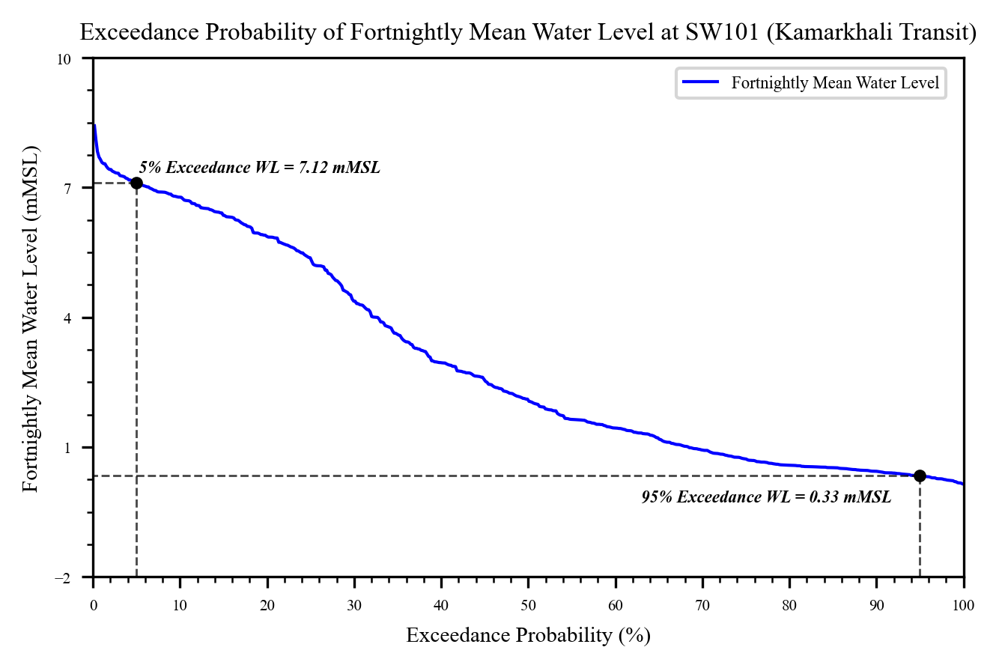

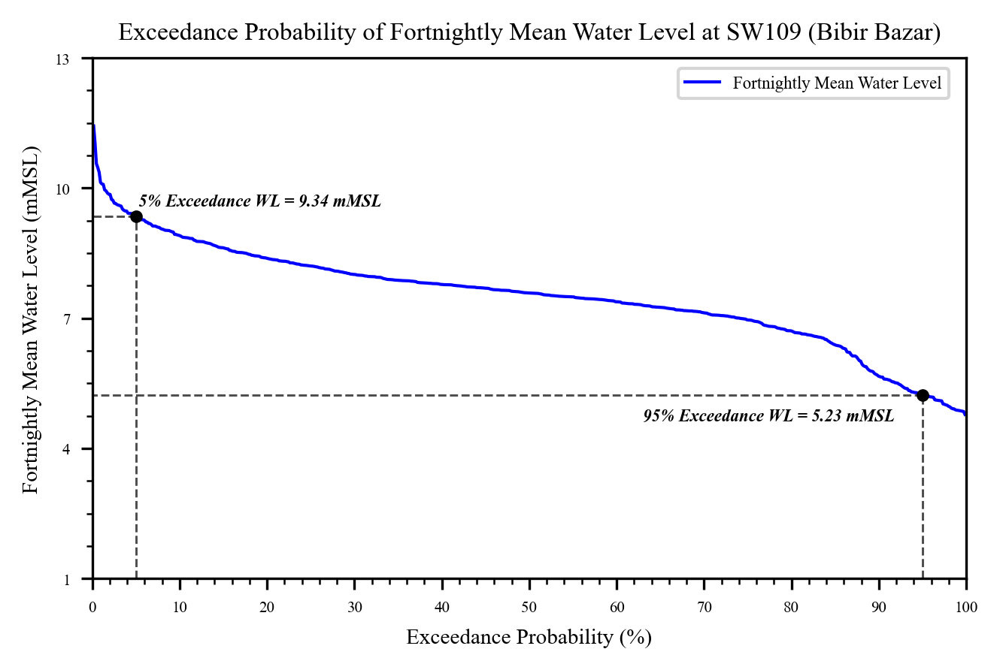

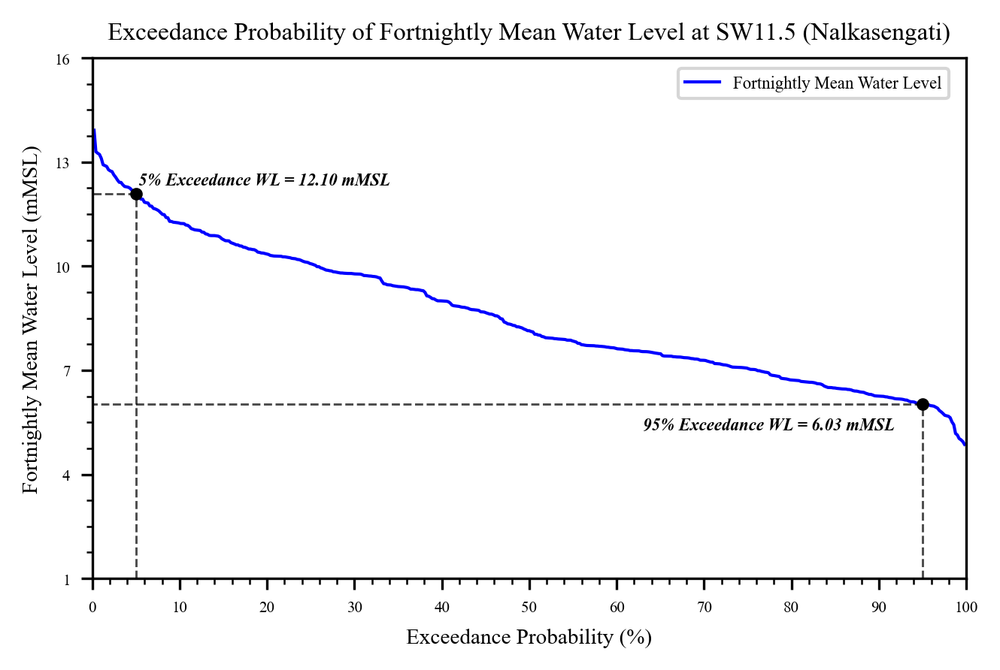

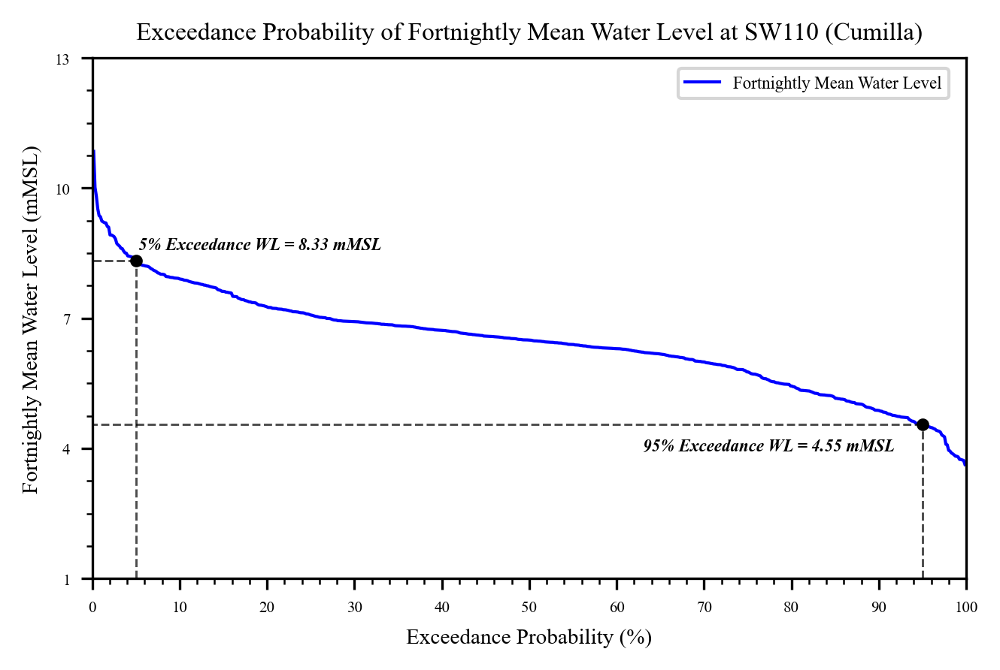

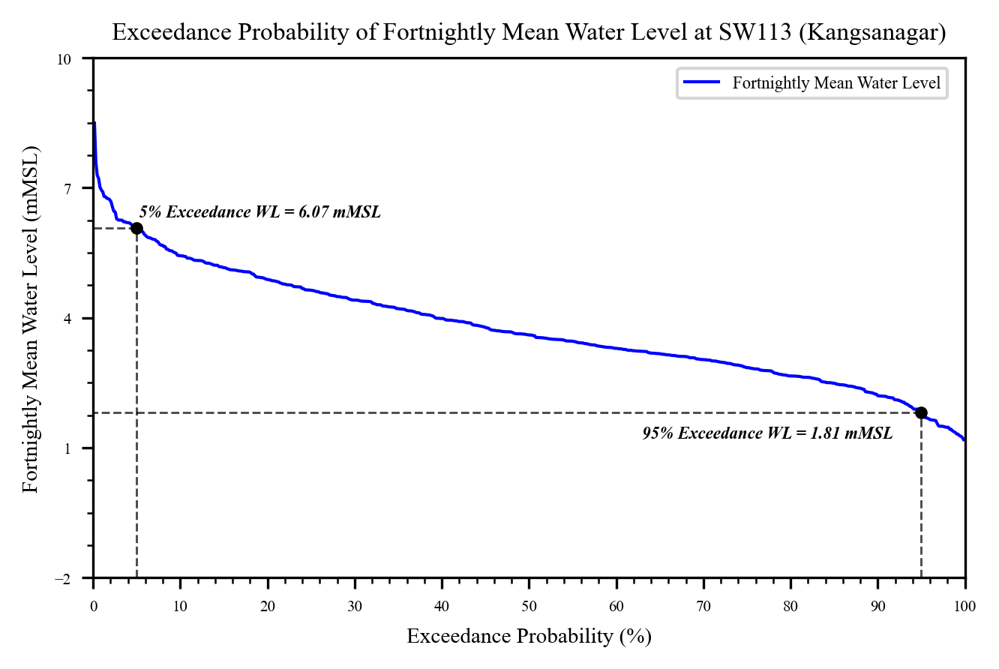

...

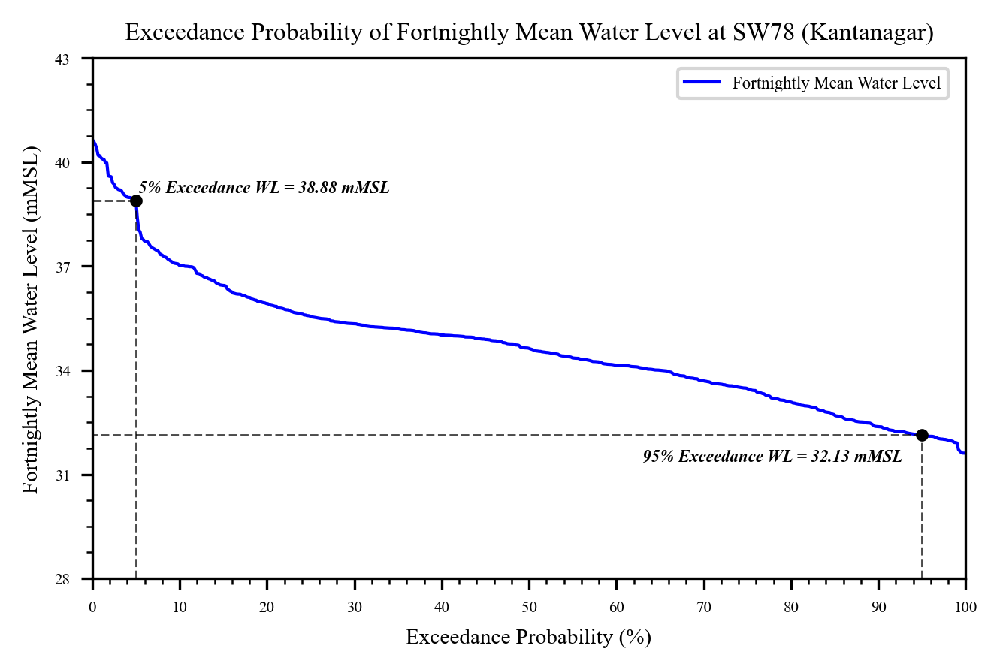

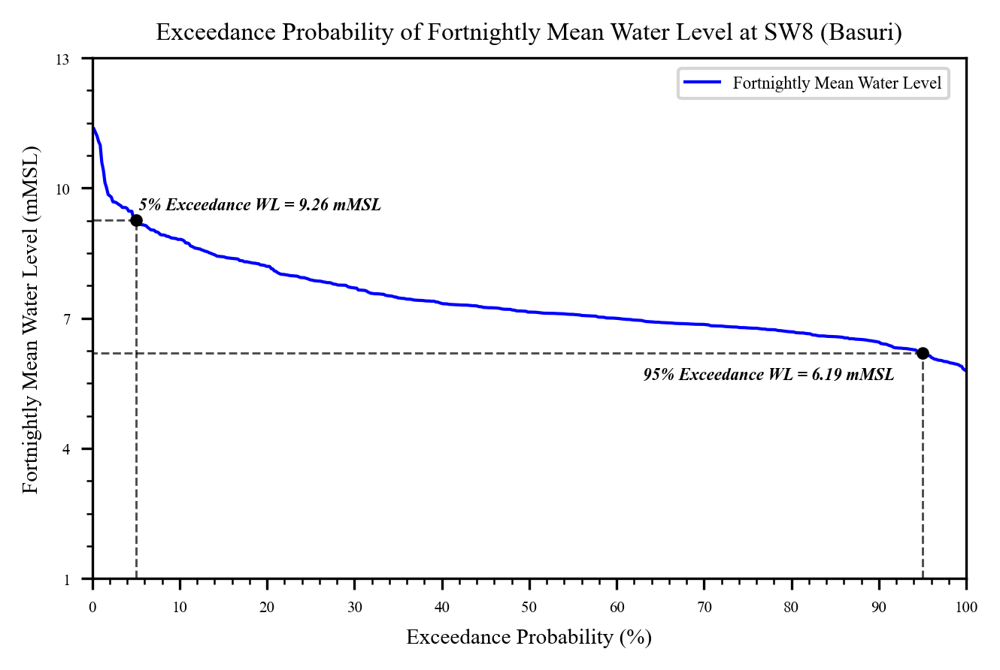

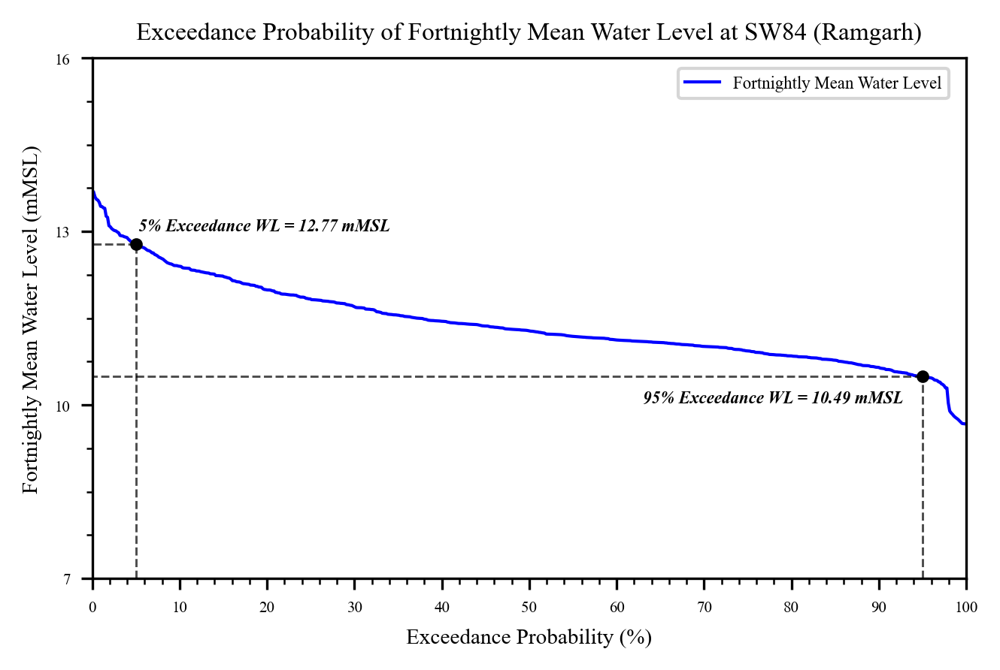

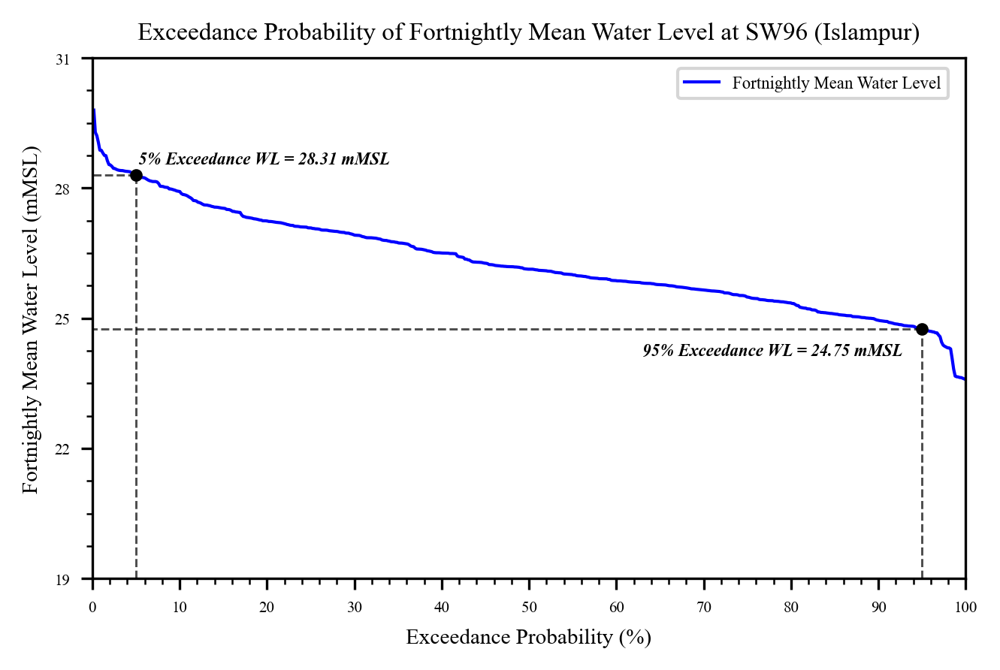

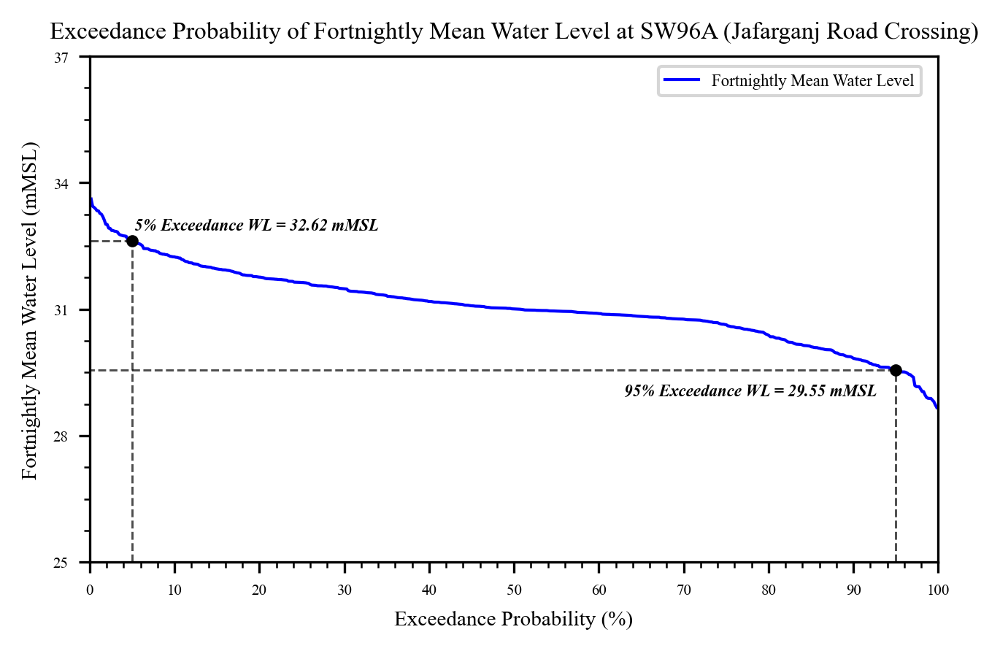

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import os
import glob

e_df = pd.DataFrame()

for file in glob.glob(r'G:\MJI\Non Tidal (172 nos.)\Output\Problem (Solved)\Fortnightly_Avg\*.xlsx'):
    
    try:
        path_list = file.split(os.sep)

        df = pd.read_excel(file)

        #Exceedance Probability Calculation

        df.dropna(subset=['Modified'],inplace = True)
        df.sort_values(by ='Modified', ascending=False, inplace = True)
        df['Ranking'] = df['Modified'].rank(method='min', ascending=False)
        df['Exceedence Probability (%)'] = (df.loc[:,'Ranking']*100)/(len(df['Modified'])+1)


        # Exceedance Probability Plotting

        font={'family':'Times New Roman',
             'weight':'normal',
             'size':5.5}

        plt.rc('font',**font)
        plt.rc('xtick',labelsize=5)
        plt.rc('ytick',labelsize=5)

        plt.figure(figsize=(5,3),dpi=300)

        x_axis = df['Exceedence Probability (%)']  # input
        y_axis = df['Modified']                # input

        plt.plot(x_axis, y_axis,lw=1,color='blue',label='Fortnightly Mean Water Level')
        plt.minorticks_on()

        ytic_round_value = 3
        y_low = y_axis.min() - (y_axis.min())% ytic_round_value-2
        y_high = y_axis.max() + (ytic_round_value - (y_axis.max())% ytic_round_value)+1
        # low,high=round(df3['WL (mMSL)'].min())-1,round(df3['WL (mMSL)'].max())+1



        plt.legend(bbox_to_anchor=(0.98, 0.98), loc=1, borderaxespad=0)

        plt.xticks(np.arange(0,100+1,10))
        plt.yticks(np.arange(y_low,y_high+1,ytic_round_value))

        plot_title = 'Exceedance Probability of Fortnightly Mean Water Level at {}'.format(path_list[-1][:-21])    # name needs to be changed
        plt.title(plot_title, fontweight= 'roman', fontsize = 8)
        plt.xlabel('Exceedance Probability (%)', fontweight= 'roman', fontsize = 7)
        plt.ylabel('Fortnightly Mean Water Level (mMSL)', fontweight= 'roman', fontsize = 7)

        plt.xlim([0, 100])
        plt.ylim([y_low, y_high])


        xvals = [5, 95]
        yinterp = np.interp(xvals, x_axis, y_axis)


        # Update 5% and 95% WL value in the final Excel

        prob_df = pd.DataFrame({'Station Name': path_list[-1][:-21], 'Exceedance Probability (%)':xvals, 
                                   'WL (mMSL)': list(yinterp) })

        e_df = pd.concat([e_df,prob_df])


        # Adding 5% and 95% WL Points in the figure
        plt.plot(xvals, yinterp, 'o', color='k', markersize=3)


        # draw dash lines for 5% exceedance level
        plt.plot([xvals[0],xvals[0]], [y_low, yinterp[0]], '--', color='k', lw=0.7, alpha = 0.7)
        plt.plot([xvals[0], 0], [yinterp[0],yinterp[0] ], '--', color='k', lw=0.7, alpha = 0.7)

        anot_label_1 = '{a}% Exceedance WL = {b} mMSL'.format(a=xvals[0],b = "%.2f" % yinterp[0])

        plt.annotate(anot_label_1, (xvals[0]+0.25, yinterp[0]+0.25), color='k',weight = 'bold', style='italic')


        # draw dash lines for 95% exceedance level
        plt.plot([xvals[1], xvals[1]], [y_low, yinterp[1]], '--', color='k', lw=0.7, alpha = 0.7)
        plt.plot([xvals[1], 0], [yinterp[1],yinterp[1] ], '--', color='k', lw=0.7, alpha = 0.7)

        anot_label_2 = '{a}% Exceedance WL = {b} mMSL'.format(a=xvals[1],b = "%.2f" % yinterp[1])

        plt.annotate(anot_label_2, (xvals[1]-32, yinterp[1]-0.75*(y_high-y_low)/(22-7)), color='k',weight = 'bold', style='italic')



        #Saving the figure
        # plt.savefig(r"{}.jpg".format('test'), bbox_inches='tight')
        plt.savefig(r"G:\MJI\Non Tidal (172 nos.)\Output\Problem (Solved)\SHWL_SLWL_from_Fortnightly_Avg\Plot\{}_EP.jpg".format(path_list[-1][:-5]), 
                    bbox_inches='tight')


        # Saving Exccedence Probability Calculation
        ep_cal_df = df[['Date/Time','Modified','Ranking','Exceedence Probability (%)']]
        ep_cal_df.to_excel(r"G:\MJI\Non Tidal (172 nos.)\Output\Problem (Solved)\SHWL_SLWL_from_Fortnightly_Avg\EP_Calculation\{}_EP.xlsx".format(path_list[-1][:-5]), 
                           float_format="%.3f")
    
        print(path_list[-1][:-5])
        
        
    except:
        print('Error!!_' + path_list[-1][:-5])


# Saving 5% and 95% Exceedance Probability Plot of Input Station
e_df.to_excel(r"G:\MJI\Non Tidal (172 nos.)\Output\Problem (Solved)\SHWL_SLWL_from_Fortnightly_Avg\Problem (Solved)_Non_Tidal_Stations_SHWL_and_SLWL.xlsx", 
              float_format="%.3f", index = None)